In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt

In [21]:
df = pd.read_csv("../data/species.csv")

In [22]:
df

,Unnamed: 0,site,model,Year,Month,Latitude,Longitude,Depth,Region,Coral_cover,...,Pop_per_area_reef_20km,Random,impact,YEAR,HABITAT_CD,REGION,PCT_CORAL,MAX_HARD_RELIEF,no.divers,Diversity_index
0,0,4733520_128U,biomass,2005,August,24.446433,-81.962900,9.800000,FLA KEYS,2.000000,...,0.047128,3786,0.205,2005,ISOL_LR,FLA KEYS,2.000000,0.550322,4,0.877755
1,1,4966028_487U,impact,2005,June,24.461130,-81.840099,8.821212,FLA KEYS,6.181818,...,0.403795,503,0.382,2005,SPGR_HR,FLA KEYS,6.181818,1.886364,4,0.912085
2,2,4981032_102U,biomass,2005,July,24.467250,-81.832367,17.399239,FLA KEYS,7.506345,...,0.392888,3430,NaN,2005,CONT_LR,FLA KEYS,7.506345,0.749873,4,0.882112
3,3,4999782_141U,impact,2005,August,24.468767,-81.822167,9.200000,FLA KEYS,10.000000,...,0.386919,3696,NaN,2005,ISOL_LR,FLA KEYS,10.000000,0.400000,4,0.806049
4,4,5026033_475U,impact,2005,June,24.470206,-81.808148,8.558032,FLA KEYS,2.870486,...,0.383887,4090,NaN,2005,ISOL_LR,FLA KEYS,2.870486,0.289415,4,0.829156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3994,3994,2065262_3278U,impact,2018,September,25.770183,-80.087650,17.953469,SEFCRI,1.000000,...,12.064380,6958,0.709,2018,APRD,SEFCRI,1.000000,0.834130,2,0.829341
3995,3995,1223281_1188U,impact,2018,September,24.580356,-81.303040,7.148084,FLA KEYS,1.246807,...,0.042837,7602,NaN,2018,CONT_LR,FLA KEYS,1.246807,0.498723,2,0.831818
3996,3996,2003949_1803U,biomass,2018,September,25.590833,-80.096706,2.455478,FLA KEYS,1.795652,...,0.402824,5480,0.705,2018,RUBB_LR,FLA KEYS,1.795652,0.535043,2,0.824709
3997,3997,1966838_3070U,impact,2018,September,25.838121,-80.099420,8.145070,SEFCRI,1.000000,...,14.823301,3575,0.740,2018,LIRI,SEFCRI,1.000000,0.601972,2,0.857023


In [23]:
df.shape

(3999, 56)

In [24]:
df0 = df.drop('Unnamed: 0', axis=1, inplace=True)

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3999 entries, 0 to 3998
Data columns (total 55 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   site                         3999 non-null   object 
 1   model                        3999 non-null   object 
 2   Year                         3999 non-null   int64  
 3   Month                        3999 non-null   object 
 4   Latitude                     3999 non-null   float64
 5   Longitude                    3999 non-null   float64
 6   Depth                        3999 non-null   float64
 7   Region                       3999 non-null   object 
 8   Coral_cover                  3292 non-null   float64
 9   Reef_complexity              3292 non-null   float64
 10  SST                          3999 non-null   float64
 11  NPP                          3999 non-null   float64
 12  Wave_exposure                3999 non-null   float64
 13  Habitat_type_class

In [27]:
df.describe()

,Year,Latitude,Longitude,Depth,Coral_cover,Reef_complexity,SST,NPP,Wave_exposure,Coral_area_UFRTM_20km,...,Rec_reliance,Commercial_pounds_landed,Pop_per_area_reef_20km,Random,impact,YEAR,PCT_CORAL,MAX_HARD_RELIEF,no.divers,Diversity_index
count,3999.000000,3999.000000,3999.000000,3999.000000,3292.000000,3292.000000,3999.000000,3999.000000,3999.000000,3999.000000,...,3910.000000,3.998000e+03,3999.000000,3999.000000,2779.000000,3999.000000,3292.000000,3292.000000,3999.000000,3999.000000
mean,2012.886222,25.361813,-80.912910,12.031226,4.549820,1.100154,23.760696,523.320811,7.322459,76727.255314,...,0.424433,6.312866e+05,6.386781,5047.471618,0.400637,2012.886222,4.549820,1.100154,3.115779,0.831469
std,3.629448,0.806724,1.051129,6.942690,5.522744,0.851008,0.552442,163.404174,0.211270,44693.794158,...,2.247541,4.861803e+05,11.092795,2919.598275,0.281552,3.629448,5.522744,0.851008,0.998422,0.114777
min,2005.000000,24.431943,-82.986818,1.300482,0.000000,0.075887,22.405206,287.664307,5.213092,12257.000000,...,-0.185000,1.706314e+05,0.000000,1.000000,0.000000,2005.000000,0.000000,0.075887,2.000000,0.000000
25%,2011.000000,24.632586,-81.695419,6.351316,1.500000,0.500000,23.608484,365.925385,7.294437,50594.000000,...,-0.185000,2.469954e+05,0.039136,2550.500000,0.174000,2011.000000,1.500000,0.500000,2.000000,0.811582
50%,2013.000000,25.123213,-80.292226,10.171806,2.758143,0.900596,23.929285,533.677063,7.368210,60682.000000,...,-0.185000,3.180504e+05,0.248873,5097.000000,0.382000,2013.000000,2.758143,0.900596,4.000000,0.867035
75%,2016.000000,26.034196,-80.092946,17.148568,5.283544,1.448243,24.200861,632.628479,7.455595,91516.000000,...,0.044000,8.556702e+05,12.681632,7602.000000,0.694000,2016.000000,5.283544,1.448243,4.000000,0.900148
max,2018.000000,27.189445,-79.993800,32.295441,55.000000,10.538338,24.436212,1330.589233,7.597482,280125.000000,...,12.140000,1.511066e+06,55.371104,9997.000000,1.000000,2018.000000,55.000000,10.538338,8.000000,0.956324


In [28]:
df

,site,model,Year,Month,Latitude,Longitude,Depth,Region,Coral_cover,Reef_complexity,...,Pop_per_area_reef_20km,Random,impact,YEAR,HABITAT_CD,REGION,PCT_CORAL,MAX_HARD_RELIEF,no.divers,Diversity_index
0,4733520_128U,biomass,2005,August,24.446433,-81.962900,9.800000,FLA KEYS,2.000000,0.550322,...,0.047128,3786,0.205,2005,ISOL_LR,FLA KEYS,2.000000,0.550322,4,0.877755
1,4966028_487U,impact,2005,June,24.461130,-81.840099,8.821212,FLA KEYS,6.181818,1.886364,...,0.403795,503,0.382,2005,SPGR_HR,FLA KEYS,6.181818,1.886364,4,0.912085
2,4981032_102U,biomass,2005,July,24.467250,-81.832367,17.399239,FLA KEYS,7.506345,0.749873,...,0.392888,3430,NaN,2005,CONT_LR,FLA KEYS,7.506345,0.749873,4,0.882112
3,4999782_141U,impact,2005,August,24.468767,-81.822167,9.200000,FLA KEYS,10.000000,0.400000,...,0.386919,3696,NaN,2005,ISOL_LR,FLA KEYS,10.000000,0.400000,4,0.806049
4,5026033_475U,impact,2005,June,24.470206,-81.808148,8.558032,FLA KEYS,2.870486,0.289415,...,0.383887,4090,NaN,2005,ISOL_LR,FLA KEYS,2.870486,0.289415,4,0.829156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3994,2065262_3278U,impact,2018,September,25.770183,-80.087650,17.953469,SEFCRI,1.000000,0.834130,...,12.064380,6958,0.709,2018,APRD,SEFCRI,1.000000,0.834130,2,0.829341
3995,1223281_1188U,impact,2018,September,24.580356,-81.303040,7.148084,FLA KEYS,1.246807,0.498723,...,0.042837,7602,NaN,2018,CONT_LR,FLA KEYS,1.246807,0.498723,2,0.831818
3996,2003949_1803U,biomass,2018,September,25.590833,-80.096706,2.455478,FLA KEYS,1.795652,0.535043,...,0.402824,5480,0.705,2018,RUBB_LR,FLA KEYS,1.795652,0.535043,2,0.824709
3997,1966838_3070U,impact,2018,September,25.838121,-80.099420,8.145070,SEFCRI,1.000000,0.601972,...,14.823301,3575,0.740,2018,LIRI,SEFCRI,1.000000,0.601972,2,0.857023


In [31]:
df["model"].unique()

array(['biomass', 'impact'], dtype=object)

In [54]:
df["model"].dtype

dtype('O')

In [55]:
def columnSep(df : pd.DataFrame) -> list:
    Cat = []
    Num = []
    for i in list(df.columns):
        if df[i].dtype == 'O':
            Cat.append(i)
        else:
            Num.append(i)
    return Cat, Num

In [58]:
Cat, Num = columnSep(df)

In [59]:
Cat

['site',
 'model',
 'Month',
 'Region',
 'Habitat_type_classLV0',
 'Habitat_type_classLV2',
 'Marine_reserve',
 'Keys_Divisions',
 'FKNMS',
 'DryTortugas',
 'BNP',
 'CoralECA',
 'HABITAT_CD',
 'REGION']

In [60]:
Num

['Year',
 'Latitude',
 'Longitude',
 'Depth',
 'Coral_cover',
 'Reef_complexity',
 'SST',
 'NPP',
 'Wave_exposure',
 'Coral_area_UFRTM_20km',
 'Coral_area_UFRTM_200km',
 'Depth_Sbrocco',
 'Deepwater',
 'FSA',
 'Marina_slips_10km',
 'Marina_slips_25km',
 'Population_20km',
 'Population_50km',
 'Recreational_fishermen_50km',
 'Tourist_fishing',
 'Artificial_reefs_1km',
 'SG_permits_50km',
 'SG_charter_permits_25km',
 'Total_gravity_intercept',
 'Total_gravity',
 'Nursery_seagrass',
 'Nursery_mangroves',
 'connectivity',
 'Comm_engagement',
 'Comm_reliance',
 'Rec_engagement',
 'Rec_reliance',
 'Commercial_pounds_landed',
 'Pop_per_area_reef_20km',
 'Random',
 'impact',
 'YEAR',
 'PCT_CORAL',
 'MAX_HARD_RELIEF',
 'no.divers',
 'Diversity_index']

In [43]:

def labelCounter(df: pd.DataFrame) -> dict:
    L = list(df.columns)
    D = {}
    for col in L:
        D[col] = len(df[col].unique())
    return D


In [69]:
labelCounter(Cat_df)

{'site': 3999,
 'model': 2,
 'Month': 8,
 'Region': 3,
 'Habitat_type_classLV0': 3,
 'Habitat_type_classLV2': 8,
 'Marine_reserve': 2,
 'Keys_Divisions': 6,
 'FKNMS': 2,
 'DryTortugas': 2,
 'BNP': 2,
 'CoralECA': 2,
 'HABITAT_CD': 20,
 'REGION': 3}

In [91]:
df['FKNMS'].isna().sum()

2341

In [62]:
Cat_df = df[Cat]
Cat_df

,site,model,Month,Region,Habitat_type_classLV0,Habitat_type_classLV2,Marine_reserve,Keys_Divisions,FKNMS,DryTortugas,BNP,CoralECA,HABITAT_CD,REGION
0,4733520_128U,biomass,August,FLA KEYS,Coral Reef and Hardbottom,Aggregate Reef,Open,Marquesas,FKNMS,NaN,NaN,NaN,ISOL_LR,FLA KEYS
1,4966028_487U,impact,June,FLA KEYS,Coral Reef and Hardbottom,Spur and Groove,Open,Marquesas,FKNMS,NaN,NaN,NaN,SPGR_HR,FLA KEYS
2,4981032_102U,biomass,July,FLA KEYS,Coral Reef and Hardbottom,Pavement,Open,Marquesas,FKNMS,NaN,NaN,NaN,CONT_LR,FLA KEYS
3,4999782_141U,impact,August,FLA KEYS,Coral Reef and Hardbottom,Pavement,Open,Marquesas,FKNMS,NaN,NaN,NaN,ISOL_LR,FLA KEYS
4,5026033_475U,impact,June,FLA KEYS,Coral Reef and Hardbottom,Pavement,Open,Lower Keys,FKNMS,NaN,NaN,NaN,ISOL_LR,FLA KEYS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3994,2065262_3278U,impact,September,SEFCRI,Coral Reef and Hardbottom,Individual or Aggregated Patch Reef,Open,NaN,NaN,NaN,NaN,CoralECA,APRD,SEFCRI
3995,1223281_1188U,impact,September,FLA KEYS,Coral Reef and Hardbottom,Pavement,Open,Lower Keys,FKNMS,NaN,NaN,NaN,CONT_LR,FLA KEYS
3996,2003949_1803U,biomass,September,FLA KEYS,Coral Reef and Hardbottom,Aggregate Reef,Open,Upper Keys,NaN,NaN,Biscayne National Park,NaN,RUBB_LR,FLA KEYS
3997,1966838_3070U,impact,September,SEFCRI,Coral Reef and Hardbottom,Aggregate Reef,Open,NaN,NaN,NaN,NaN,CoralECA,LIRI,SEFCRI


In [64]:
Num_df = df[Num]
Num_df

,Year,Latitude,Longitude,Depth,Coral_cover,Reef_complexity,SST,NPP,Wave_exposure,Coral_area_UFRTM_20km,...,Rec_reliance,Commercial_pounds_landed,Pop_per_area_reef_20km,Random,impact,YEAR,PCT_CORAL,MAX_HARD_RELIEF,no.divers,Diversity_index
0,2005,24.446433,-81.962900,9.800000,2.000000,0.550322,23.595392,550.865051,6.992729,88333,...,-0.185,1511066.2,0.047128,3786,0.205,2005,2.000000,0.550322,4,0.877755
1,2005,24.461130,-81.840099,8.821212,6.181818,1.886364,23.578271,577.431946,6.950751,91742,...,-0.185,855670.2,0.403795,503,0.382,2005,6.181818,1.886364,4,0.912085
2,2005,24.467250,-81.832367,17.399239,7.506345,0.749873,23.551355,595.320252,6.950181,94607,...,-0.185,855670.2,0.392888,3430,NaN,2005,7.506345,0.749873,4,0.882112
3,2005,24.468767,-81.822167,9.200000,10.000000,0.400000,23.556451,590.443543,6.959807,96139,...,-0.185,855670.2,0.386919,3696,NaN,2005,10.000000,0.400000,4,0.806049
4,2005,24.470206,-81.808148,8.558032,2.870486,0.289415,23.567590,579.874023,6.914992,98167,...,-0.185,855670.2,0.383887,4090,NaN,2005,2.870486,0.289415,4,0.829156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3994,2018,25.770183,-80.087650,17.953469,1.000000,0.834130,24.261774,453.504700,7.363275,76608,...,-0.185,318050.4,12.064380,6958,0.709,2018,1.000000,0.834130,2,0.829341
3995,2018,24.580356,-81.303040,7.148084,1.246807,0.498723,23.749170,583.637329,7.319593,146627,...,-0.056,855670.2,0.042837,7602,NaN,2018,1.246807,0.498723,2,0.831818
3996,2018,25.590833,-80.096706,2.455478,1.795652,0.535043,24.121240,553.635559,7.216960,40370,...,-0.185,318050.4,0.402824,5480,0.705,2018,1.795652,0.535043,2,0.824709
3997,2018,25.838121,-80.099420,8.145070,1.000000,0.601972,24.224939,386.825714,7.371410,85071,...,-0.185,318050.4,14.823301,3575,0.740,2018,1.000000,0.601972,2,0.857023


In [39]:
biomass_count = df['model'].value_counts().get('biomass', 0)
total_count = len(df['model'])
proportion = biomass_count / total_count

print("Proportion of 'biomass':", proportion)

Proportion of 'biomass': 0.5036259064766192


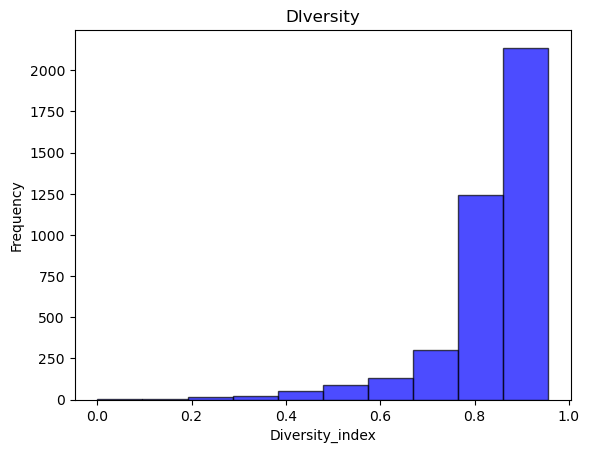

In [73]:
df['Diversity_index'].plot(kind='hist', bins=10, alpha=0.7, color='blue', edgecolor='black', title='DIversity')
plt.xlabel('Diversity_index')
plt.ylabel('Frequency')
plt.show()


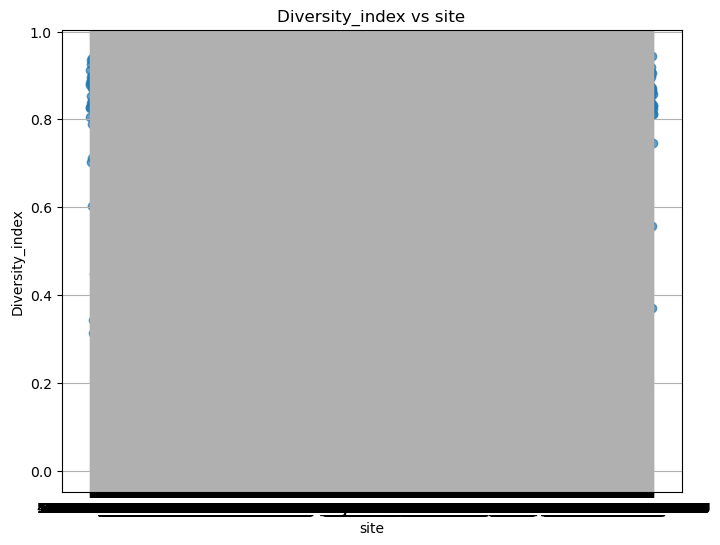

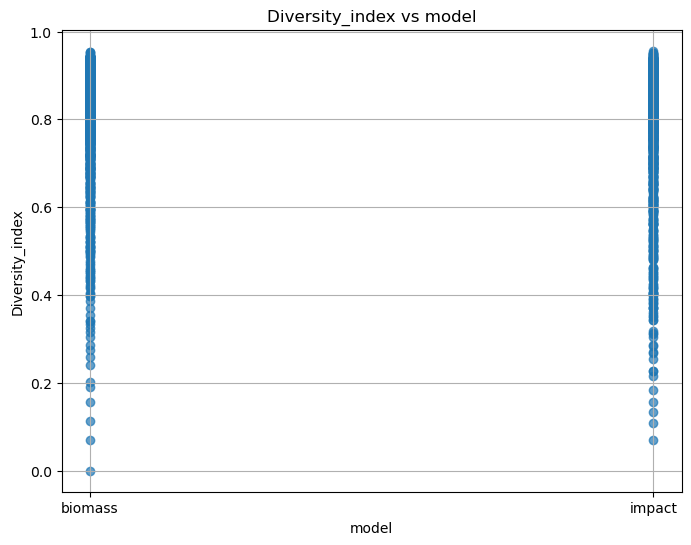

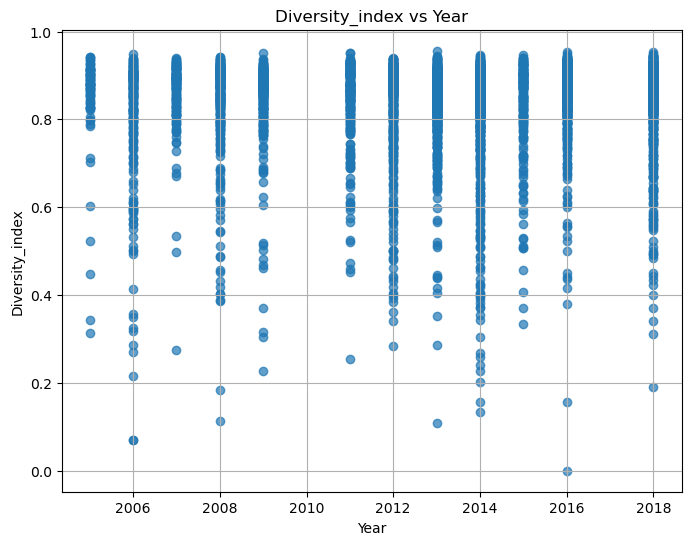

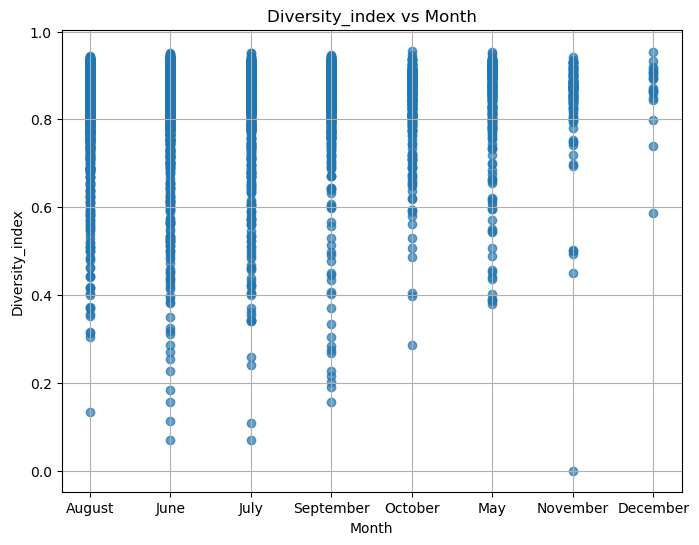

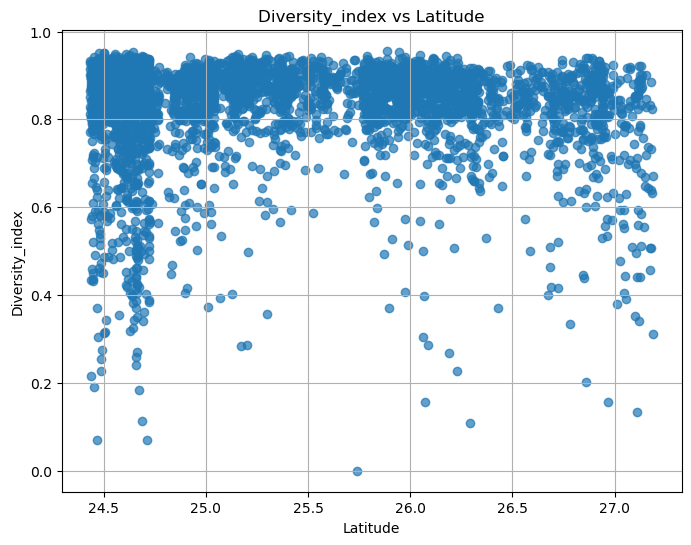

...

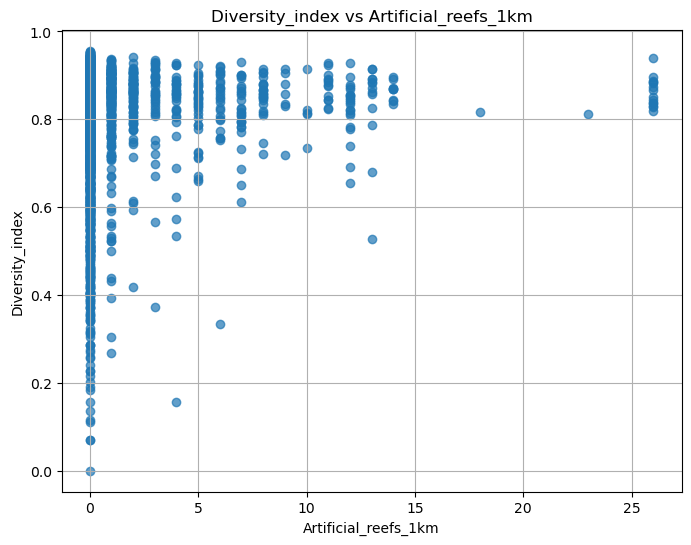

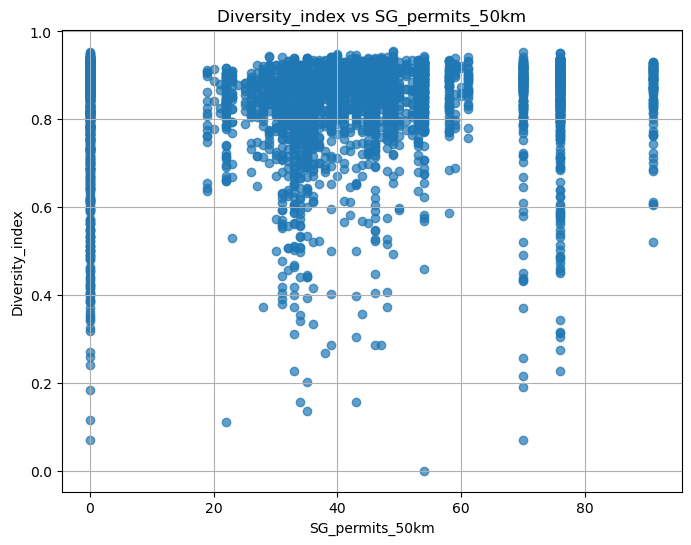

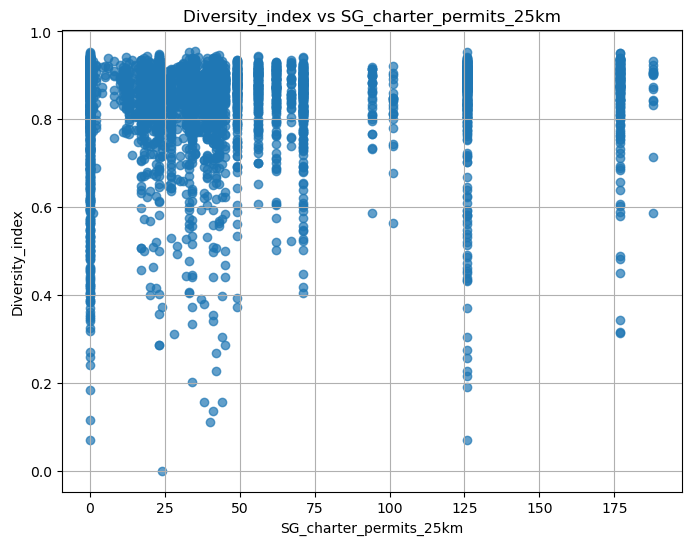

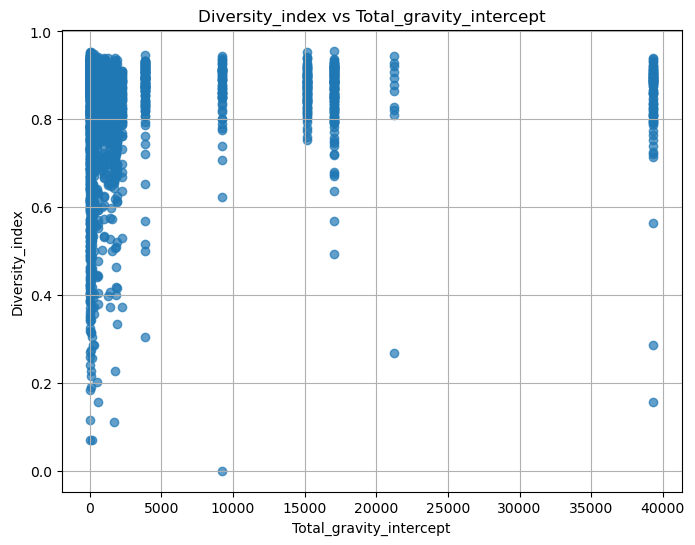

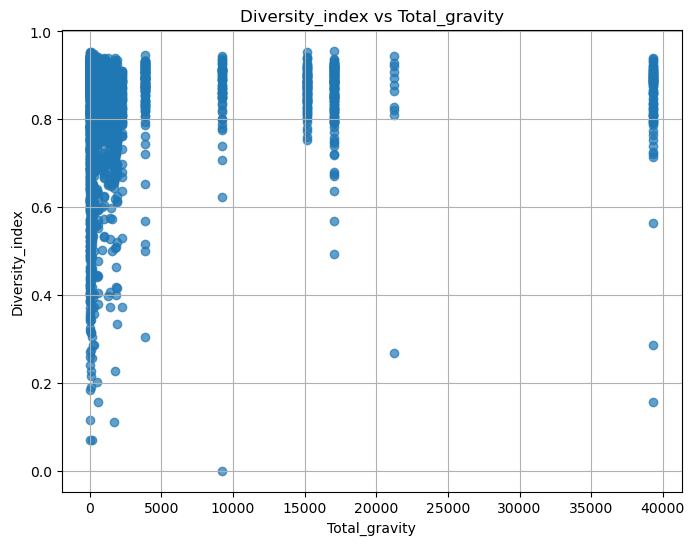

TypeError: 'value' must be an instance of str or bytes, not a float

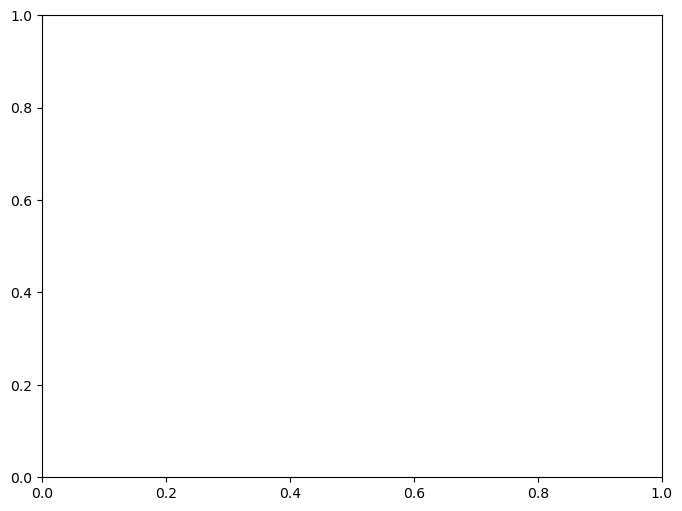

In [74]:
# Define the target feature
target = 'Diversity_index'

# Plotting the target feature against other columns
for column in df.columns:
    if column != target:
        plt.figure(figsize=(8, 6))
        plt.scatter(df[column], df[target], alpha=0.7)
        plt.title(f'{target} vs {column}')
        plt.xlabel(column)
        plt.ylabel(target)
        plt.grid(True)
        plt.show()

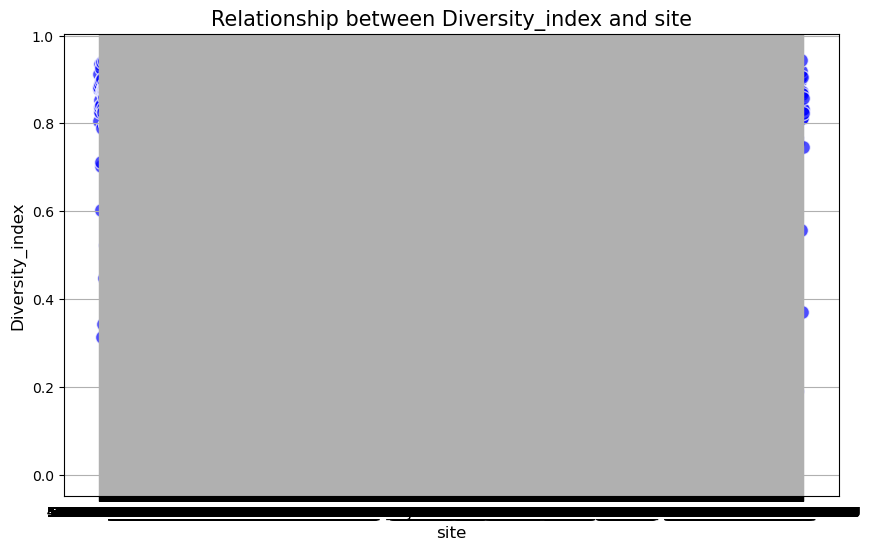

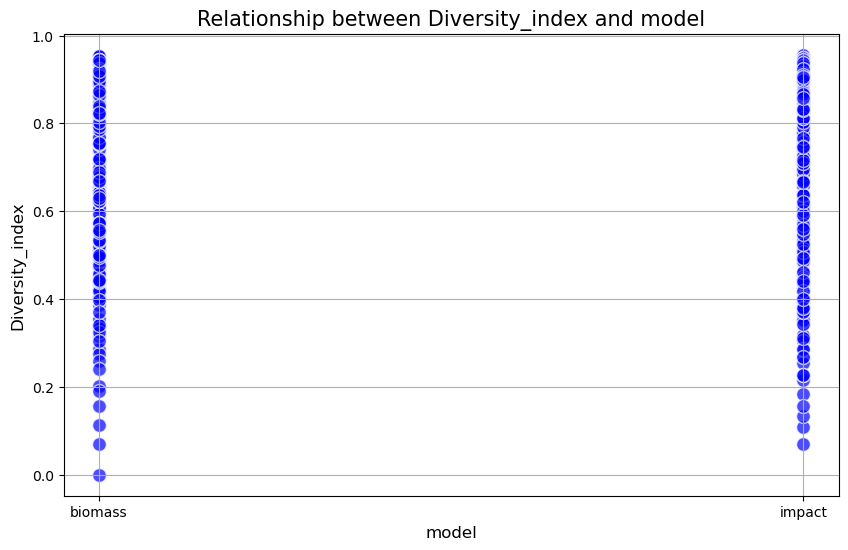

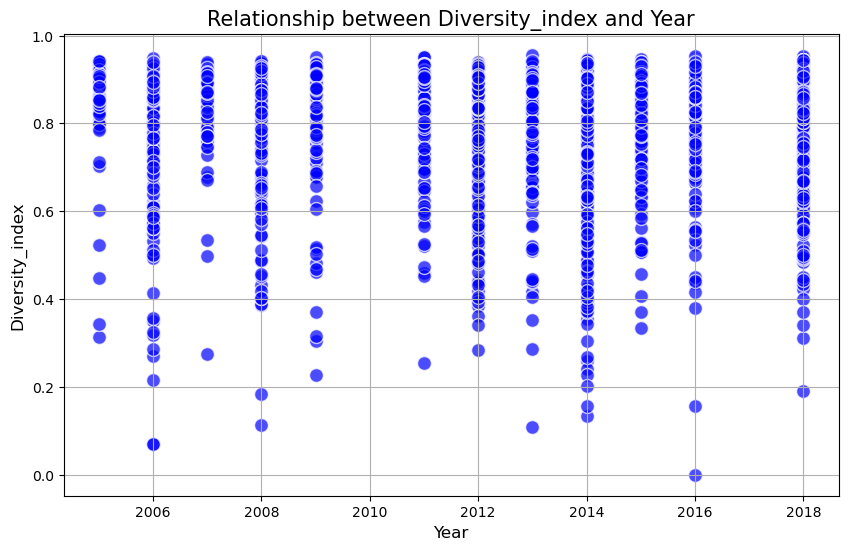

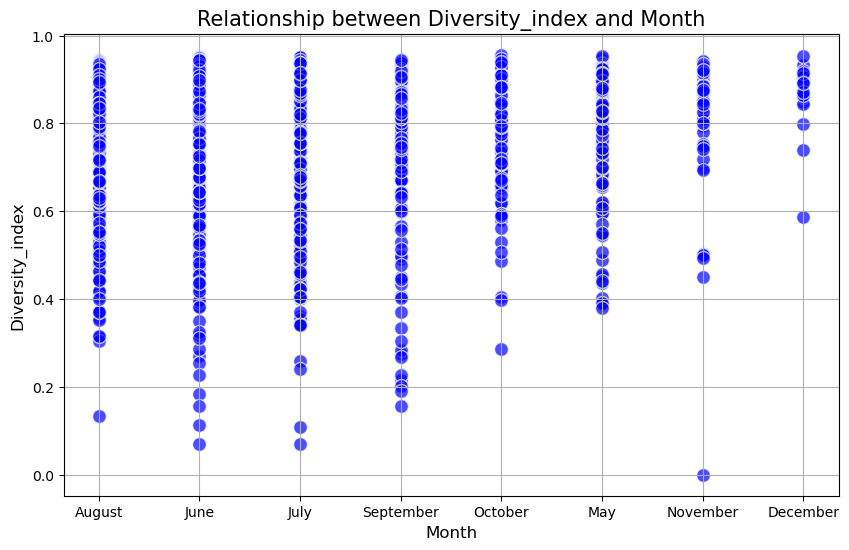

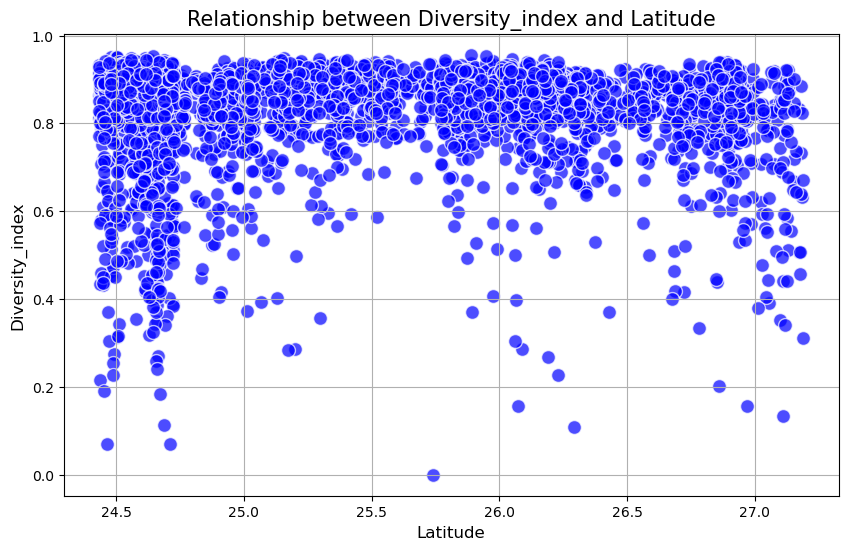

...

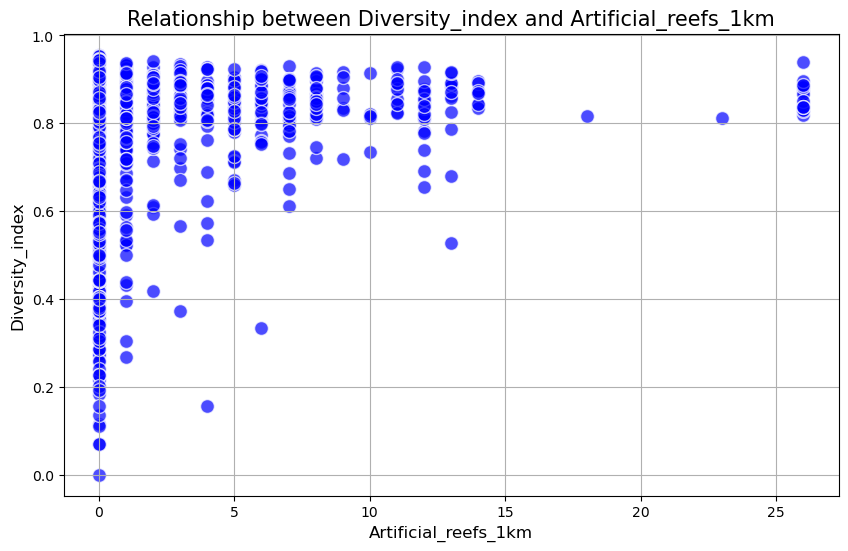

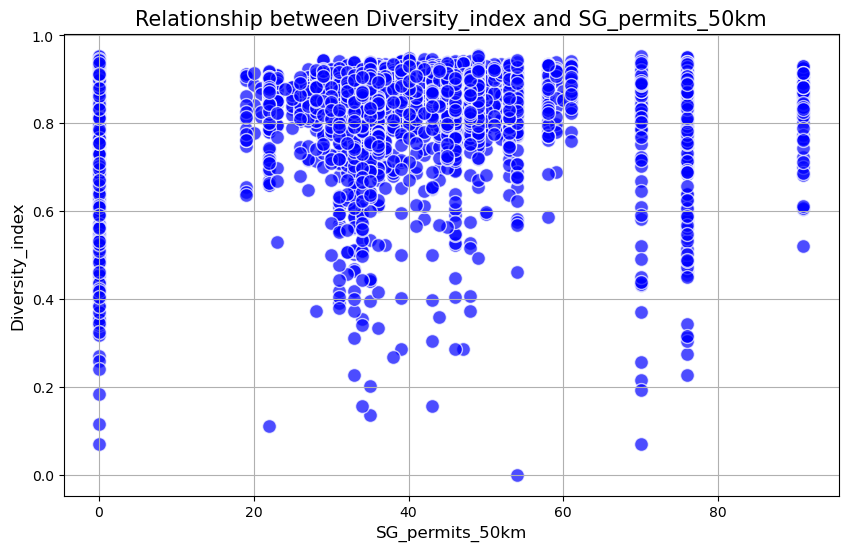

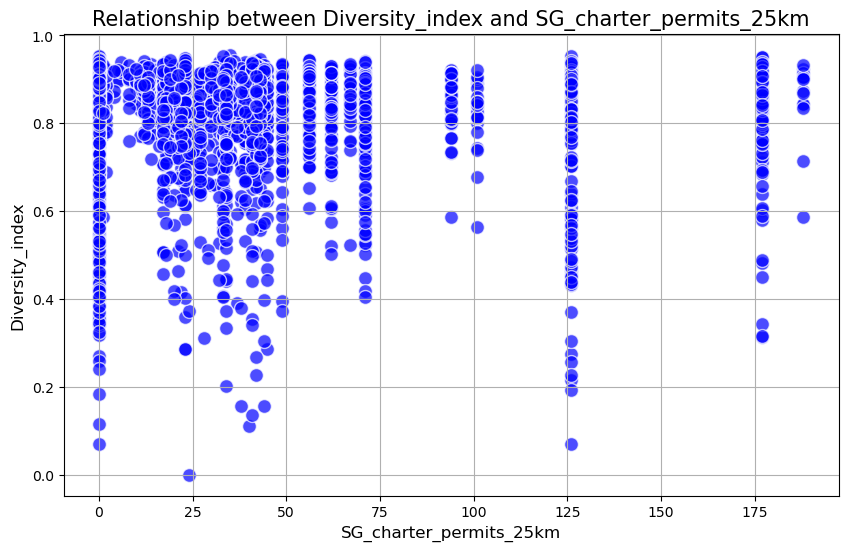

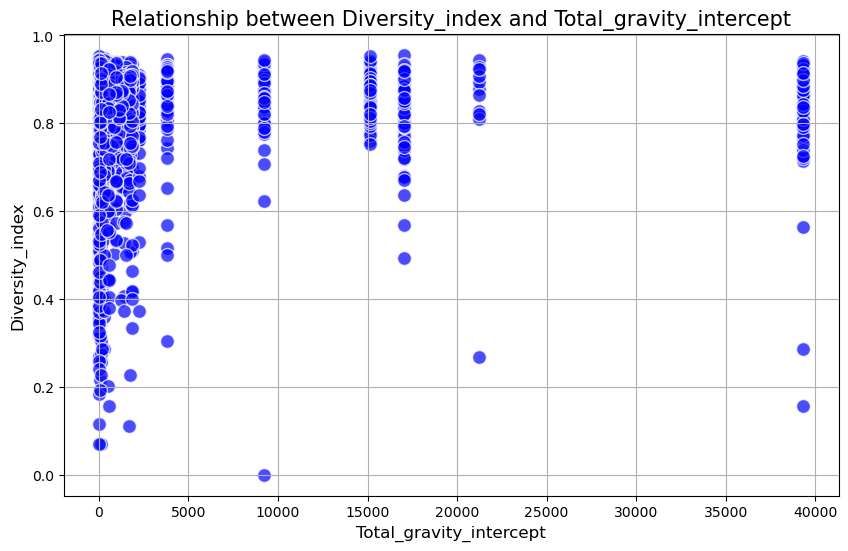

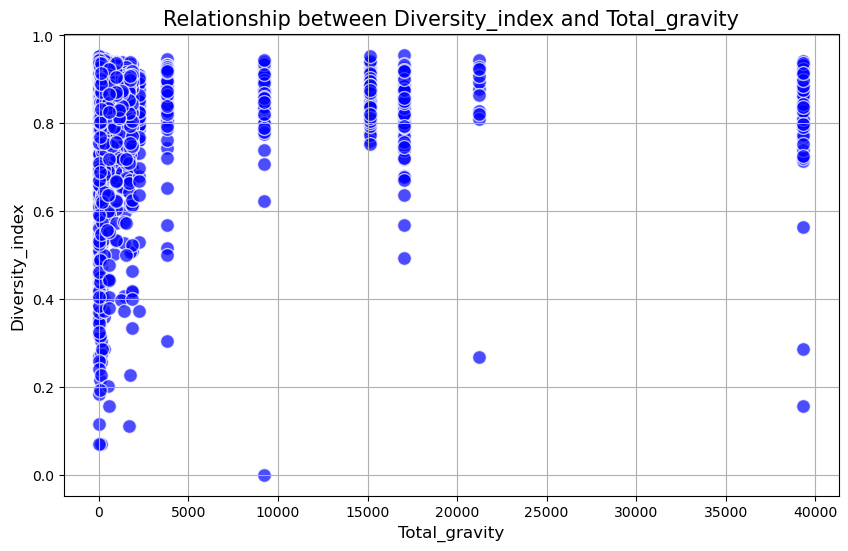

TypeError: 'value' must be an instance of str or bytes, not a float

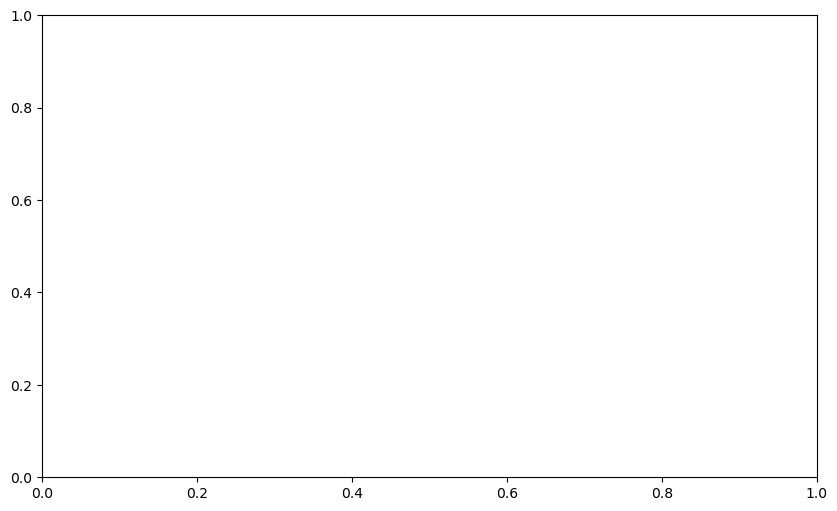

In [75]:
for column in df.columns:
    if column != target:
        plt.figure(figsize=(10, 6))
        plt.scatter(df[column], df[target], alpha=0.7, color='blue', edgecolors='w', s=100)
        plt.title(f'Relationship between {target} and {column}', fontsize=15)
        plt.xlabel(column, fontsize=12)
        plt.ylabel(target, fontsize=12)
        plt.grid(True)
        plt.show()


In [76]:
Cat_df['Diversity_index'] = df['Diversity_index']

C:\Users\chidi\AppData\Local\Temp\ipykernel_1412\2237339998.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Cat_df['Diversity_index'] = df['Diversity_index']


In [78]:
Cat_df

,site,model,Month,Region,Habitat_type_classLV0,Habitat_type_classLV2,Marine_reserve,Keys_Divisions,FKNMS,DryTortugas,BNP,CoralECA,HABITAT_CD,REGION,Diversity_index
0,4733520_128U,biomass,August,FLA KEYS,Coral Reef and Hardbottom,Aggregate Reef,Open,Marquesas,FKNMS,NaN,NaN,NaN,ISOL_LR,FLA KEYS,0.877755
1,4966028_487U,impact,June,FLA KEYS,Coral Reef and Hardbottom,Spur and Groove,Open,Marquesas,FKNMS,NaN,NaN,NaN,SPGR_HR,FLA KEYS,0.912085
2,4981032_102U,biomass,July,FLA KEYS,Coral Reef and Hardbottom,Pavement,Open,Marquesas,FKNMS,NaN,NaN,NaN,CONT_LR,FLA KEYS,0.882112
3,4999782_141U,impact,August,FLA KEYS,Coral Reef and Hardbottom,Pavement,Open,Marquesas,FKNMS,NaN,NaN,NaN,ISOL_LR,FLA KEYS,0.806049
4,5026033_475U,impact,June,FLA KEYS,Coral Reef and Hardbottom,Pavement,Open,Lower Keys,FKNMS,NaN,NaN,NaN,ISOL_LR,FLA KEYS,0.829156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3994,2065262_3278U,impact,September,SEFCRI,Coral Reef and Hardbottom,Individual or Aggregated Patch Reef,Open,NaN,NaN,NaN,NaN,CoralECA,APRD,SEFCRI,0.829341
3995,1223281_1188U,impact,September,FLA KEYS,Coral Reef and Hardbottom,Pavement,Open,Lower Keys,FKNMS,NaN,NaN,NaN,CONT_LR,FLA KEYS,0.831818
3996,2003949_1803U,biomass,September,FLA KEYS,Coral Reef and Hardbottom,Aggregate Reef,Open,Upper Keys,NaN,NaN,Biscayne National Park,NaN,RUBB_LR,FLA KEYS,0.824709
3997,1966838_3070U,impact,September,SEFCRI,Coral Reef and Hardbottom,Aggregate Reef,Open,NaN,NaN,NaN,NaN,CoralECA,LIRI,SEFCRI,0.857023


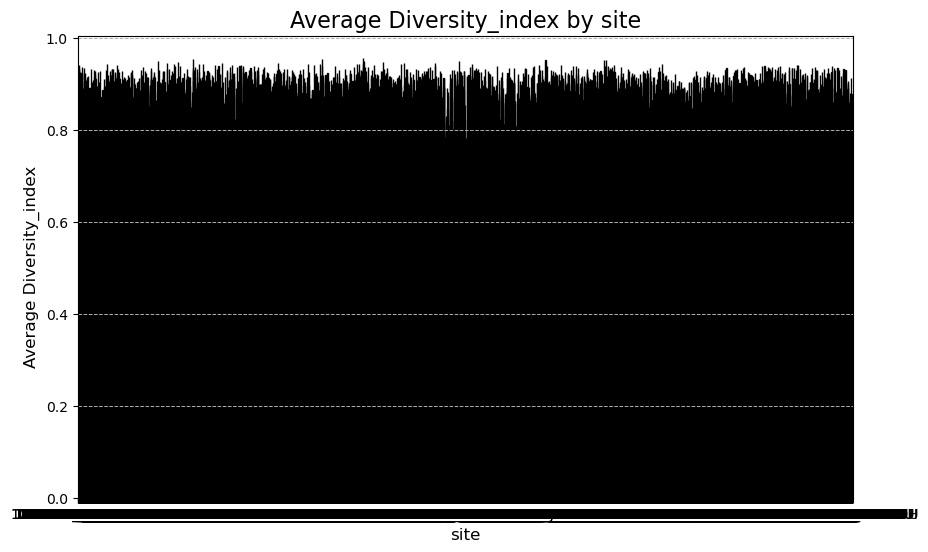

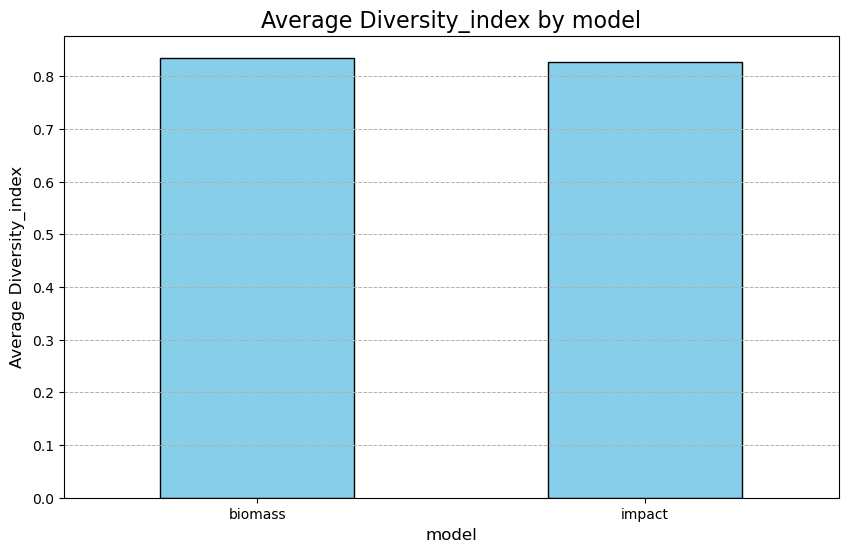

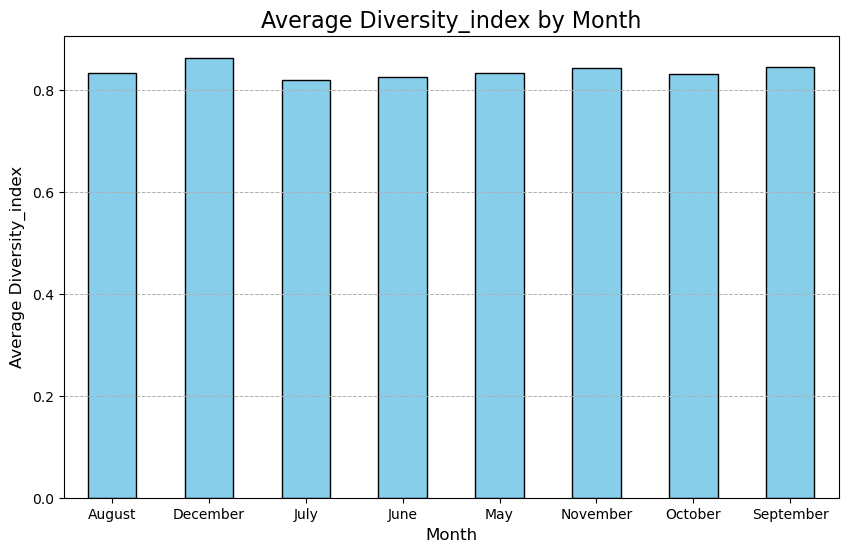

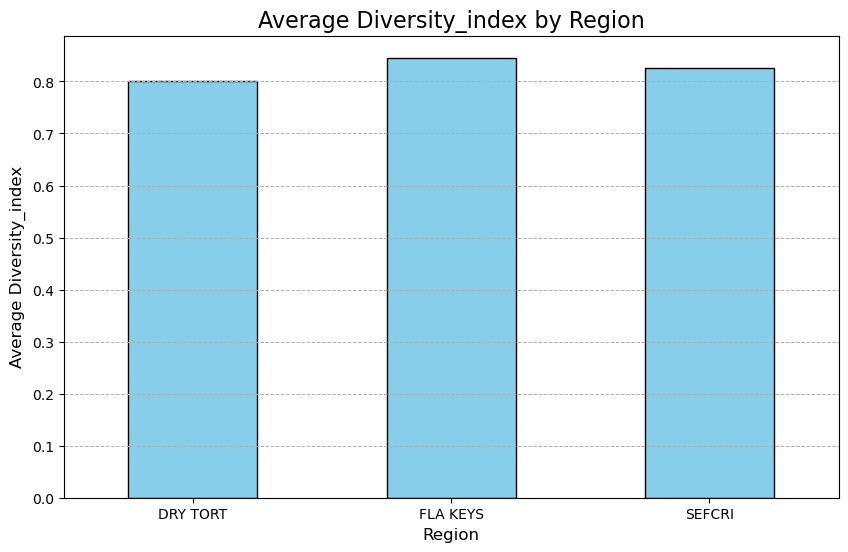

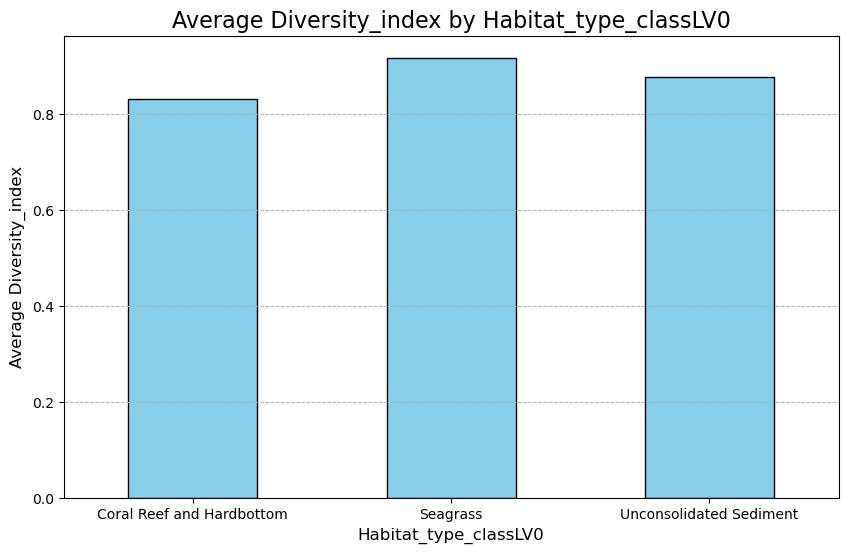

...

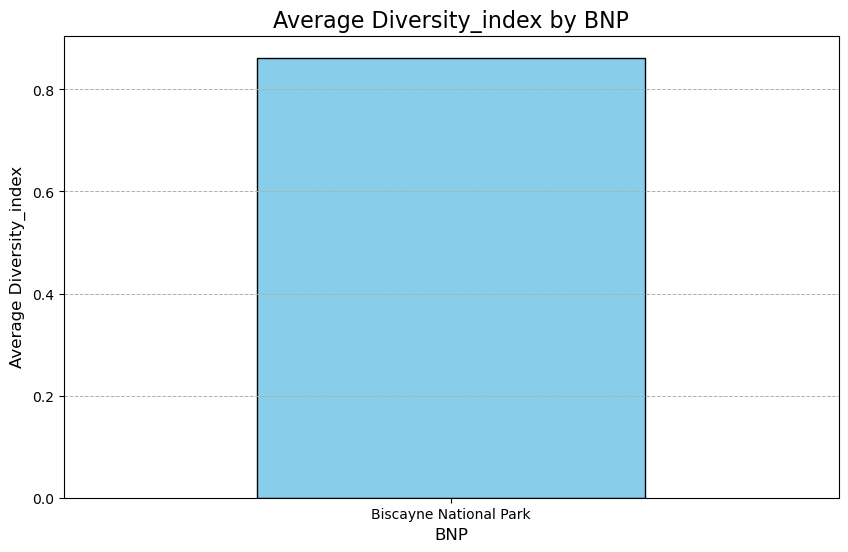

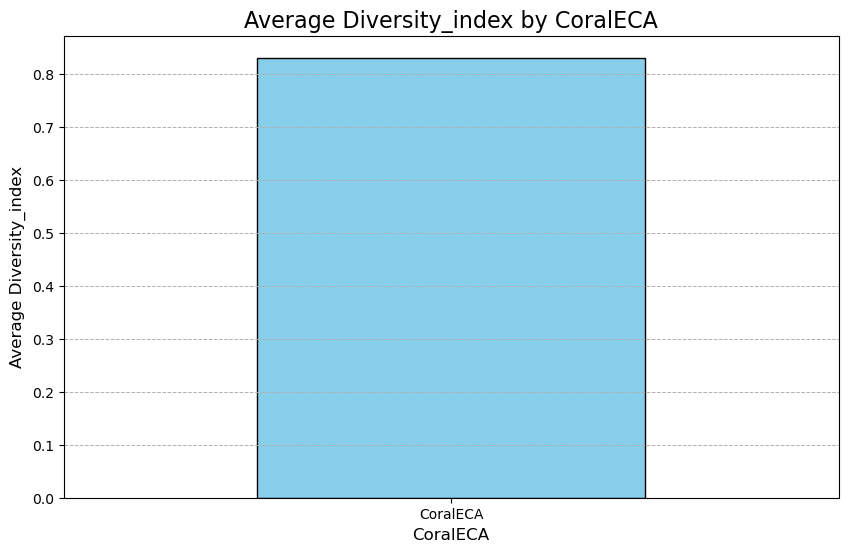

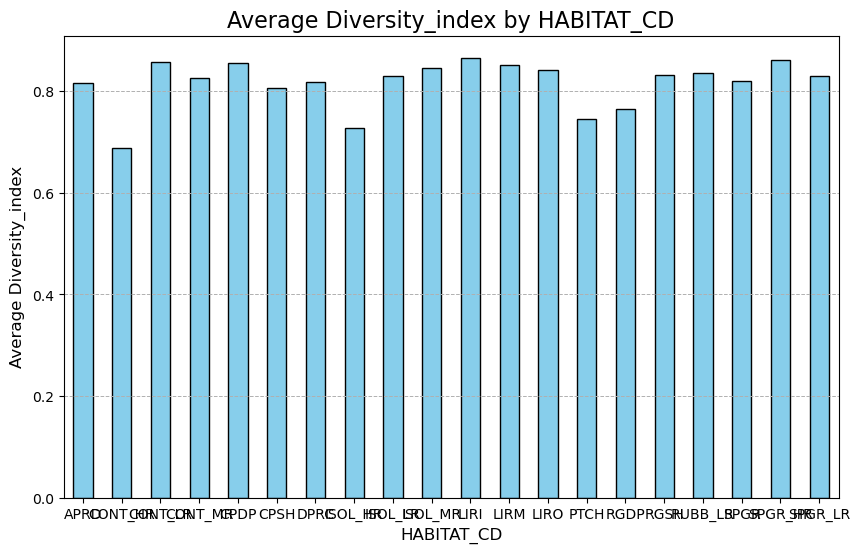

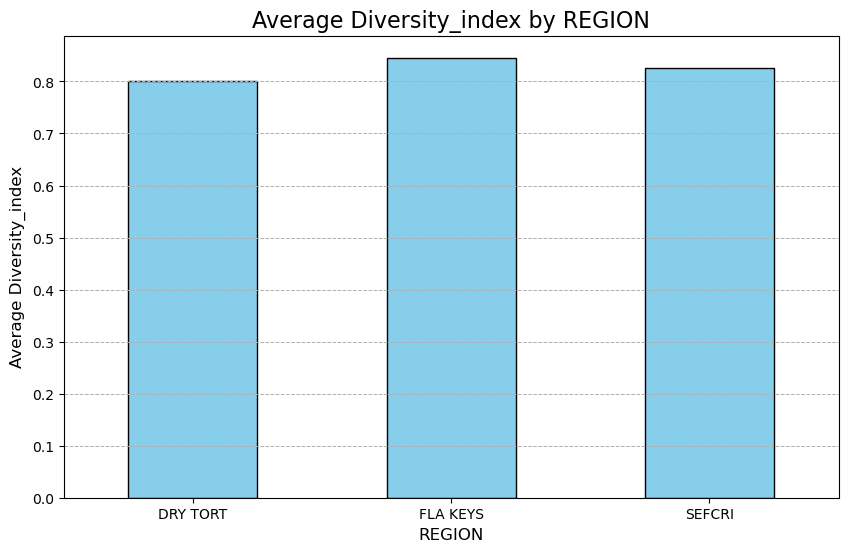

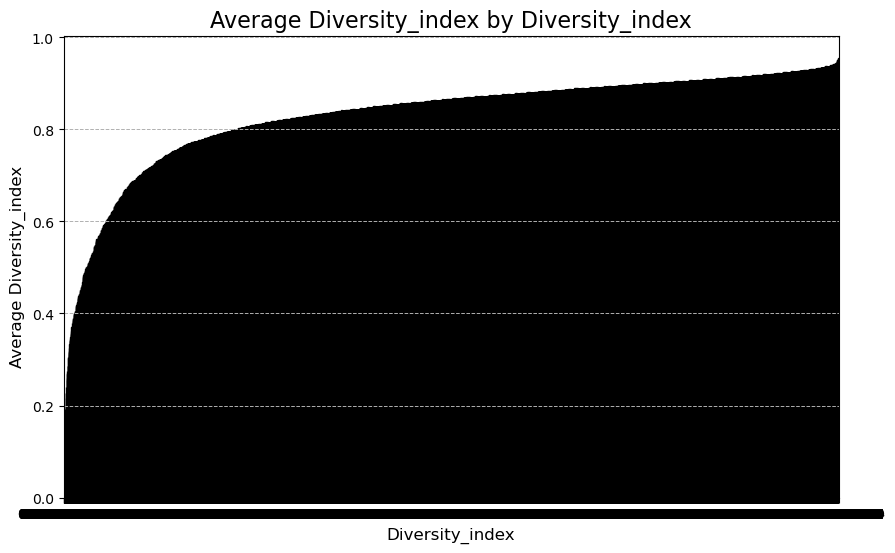

In [84]:
for column in Cat_df.columns:
    if column != target or 'site':
        plt.figure(figsize=(10, 6))
        df.groupby(column)[target].mean().plot(kind='bar', color='skyblue', edgecolor='black')
        plt.title(f'Average {target} by {column}', fontsize=16)
        plt.xlabel(column, fontsize=12)
        plt.ylabel(f'Average {target}', fontsize=12)
        plt.xticks(rotation=0)
        plt.grid(axis='y', linestyle='--', linewidth=0.7)
        plt.show()


In [103]:
# Specify columns to exclude
exclude_columns = ['site', 'Diversity_index']

# Calculate and display the ratio of each unique label and NaN in each column, excluding specified columns
for col in Cat_df.columns:
    if col not in exclude_columns:
        print(f"Column: {col}")
        counts = Cat_df[col].value_counts(dropna=False, normalize=True)
        for label, ratio in counts.items():
            label_display = label if pd.notna(label) else 'NaN'
            print(f"Label: {label_display}, Ratio: {ratio:.2%}")
        print("\n")

Column: model
Label: biomass, Ratio: 50.36%
Label: impact, Ratio: 49.64%


Column: Month
Label: August, Ratio: 27.46%
Label: June, Ratio: 22.68%
Label: September, Ratio: 17.23%
Label: July, Ratio: 16.20%
Label: October, Ratio: 6.93%
Label: May, Ratio: 6.08%
Label: November, Ratio: 2.93%
Label: December, Ratio: 0.50%


Column: Region
Label: FLA KEYS, Ratio: 47.81%
Label: SEFCRI, Ratio: 35.76%
Label: DRY TORT, Ratio: 16.43%


Column: Habitat_type_classLV0
Label: Coral Reef and Hardbottom, Ratio: 99.72%
Label: Unconsolidated Sediment, Ratio: 0.18%
Label: Seagrass, Ratio: 0.10%


Column: Habitat_type_classLV2
Label: Aggregate Reef, Ratio: 32.23%
Label: Pavement, Ratio: 14.30%
Label: Ridge, Ratio: 13.50%
Label: Individual or Aggregated Patch Reef, Ratio: 13.30%
Label: Spur and Groove, Ratio: 10.45%
Label: Pavement with Sand Channels, Ratio: 8.08%
Label: Colonized Pavement, Ratio: 5.80%
Label: Reef Rubble, Ratio: 2.33%


Column: Marine_reserve
Label: Open, Ratio: 90.17%
Label: Closed, Ratio:

C:\Users\chidi\AppData\Local\Temp\ipykernel_1412\1331956014.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<Figure size 1500x1000 with 0 Axes>

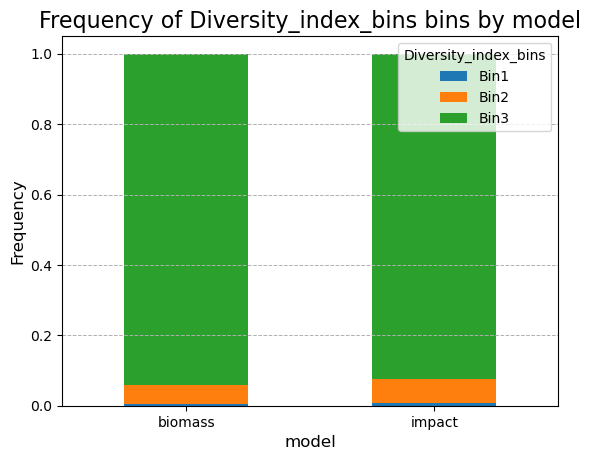

<Figure size 1500x1000 with 0 Axes>

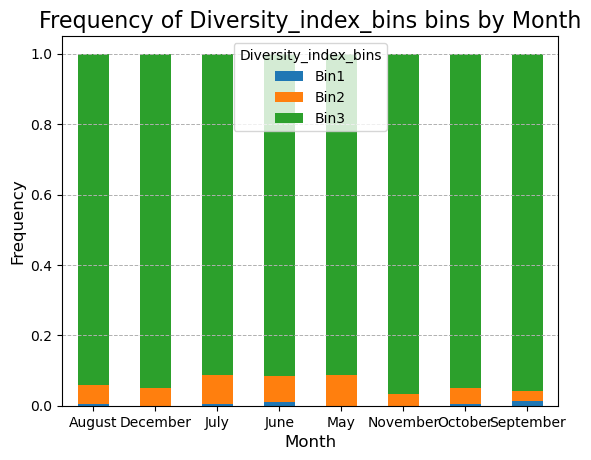

<Figure size 1500x1000 with 0 Axes>

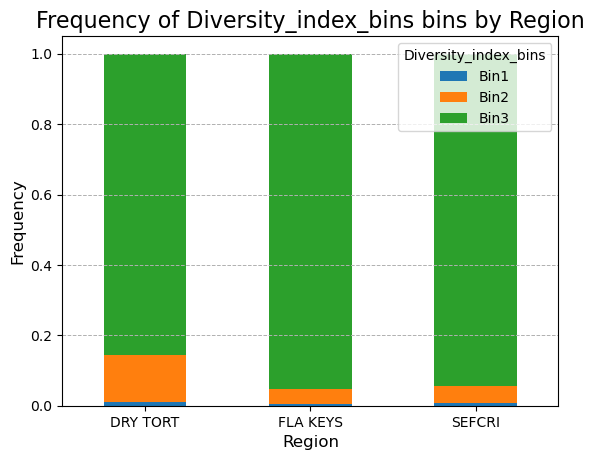

<Figure size 1500x1000 with 0 Axes>

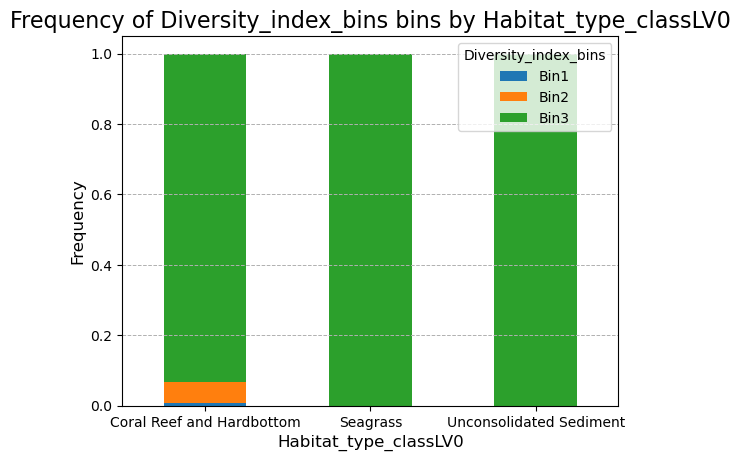

<Figure size 1500x1000 with 0 Axes>

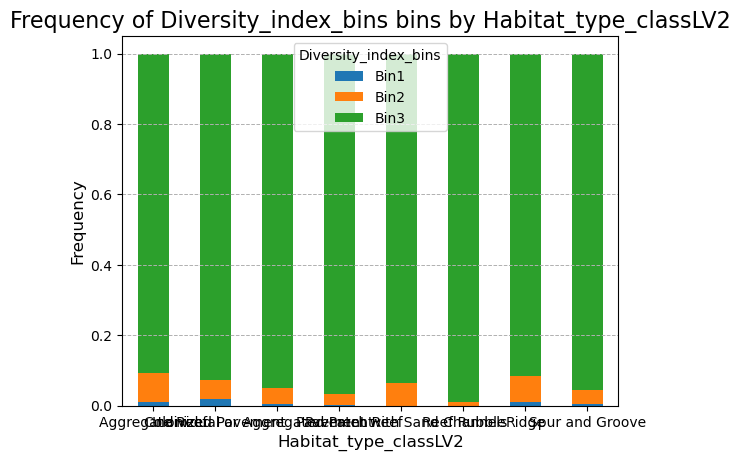

<Figure size 1500x1000 with 0 Axes>

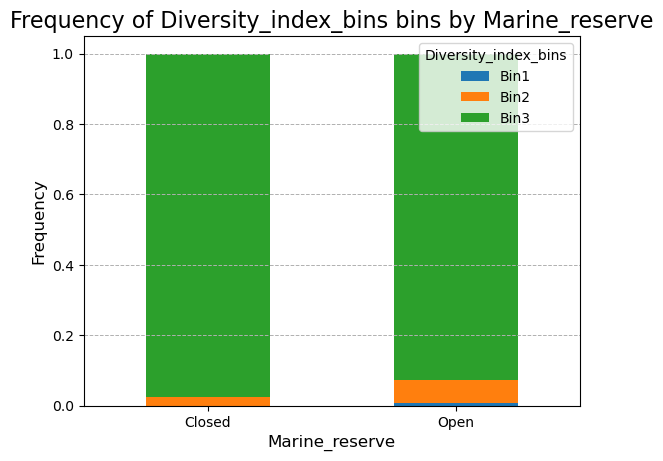

<Figure size 1500x1000 with 0 Axes>

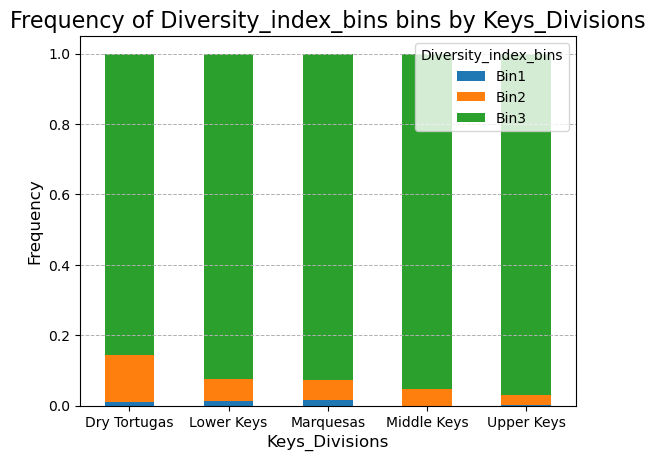

<Figure size 1500x1000 with 0 Axes>

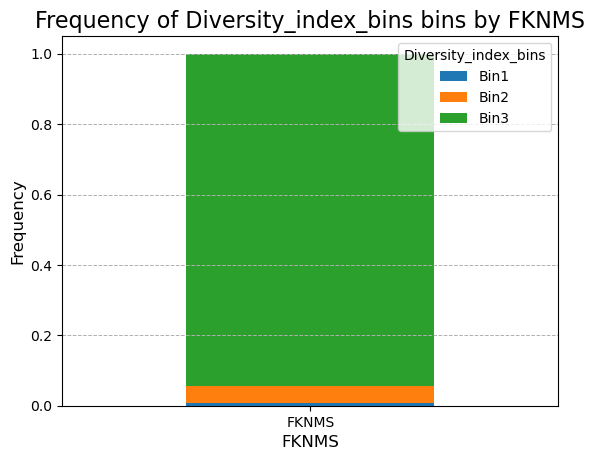

<Figure size 1500x1000 with 0 Axes>

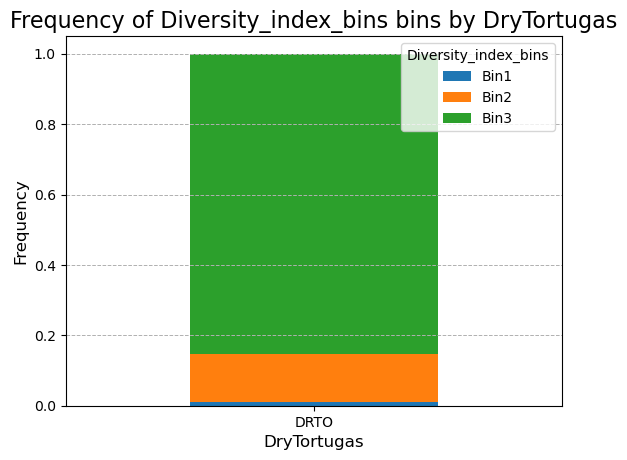

<Figure size 1500x1000 with 0 Axes>

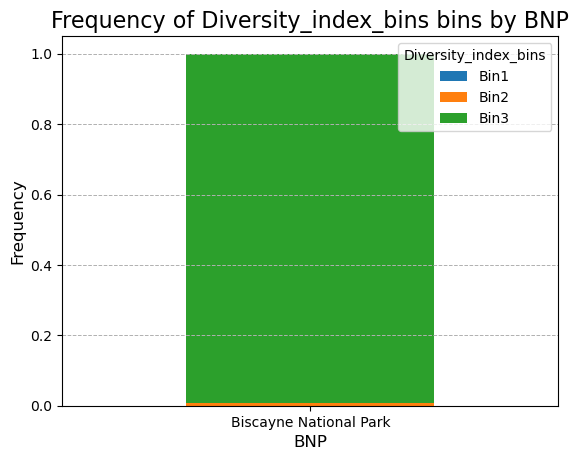

<Figure size 1500x1000 with 0 Axes>

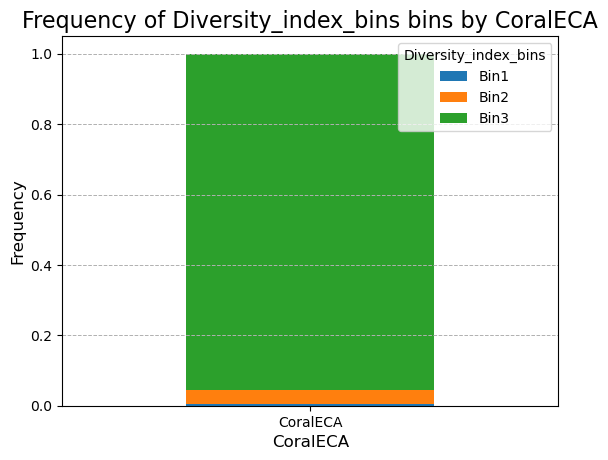

<Figure size 1500x1000 with 0 Axes>

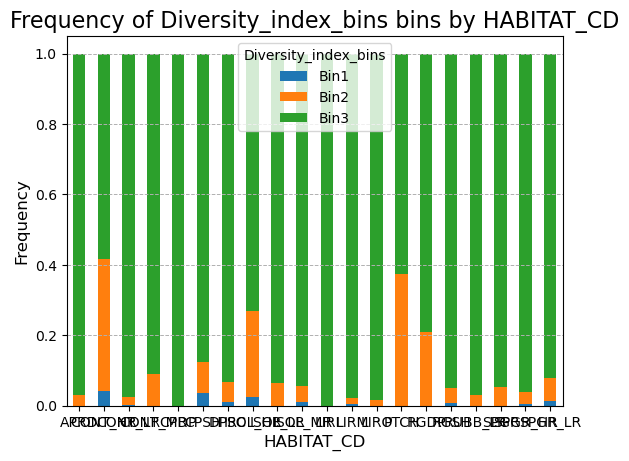

<Figure size 1500x1000 with 0 Axes>

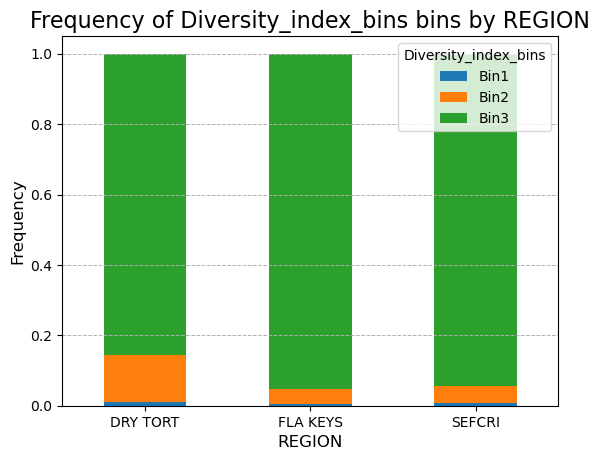

<Figure size 1500x1000 with 0 Axes>

C:\Users\chidi\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



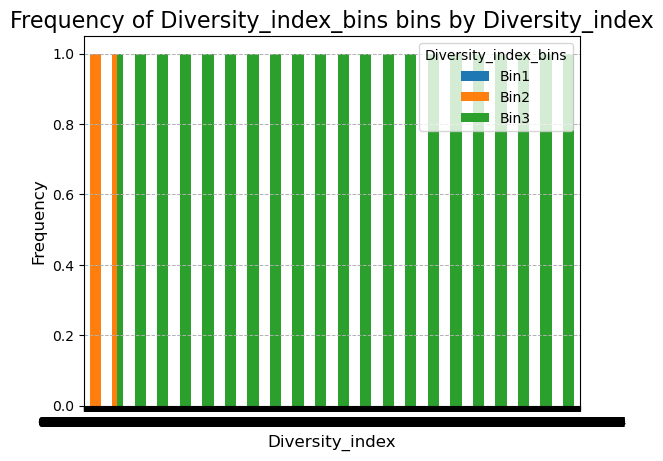

In [108]:
# Define the number of bins and the bin edges for Diversity_index
num_bins = 3
bin_edges = np.linspace(start=Cat_df['Diversity_index'].min(), stop=Cat_df['Diversity_index'].max(), num=num_bins + 1)

# Cut Diversity_index into bins
Cat_df['Diversity_index_bins'] = pd.cut(Cat_df['Diversity_index'], bins=bin_edges, labels=[f'Bin{i}' for i in range(1, num_bins + 1)])

# Plot average target by each column and show frequency of Diversity_index bins
target = 'Diversity_index_bins'

for column in Cat_df.columns:
    if column not in [target, 'site']:  # Exclude 'site' and the target column itself
        plt.figure(figsize=(15, 10))
        Cat_df.groupby(column)[target].value_counts(normalize=True).unstack().plot(kind='bar', stacked=True)
        plt.title(f'Frequency of {target} bins by {column}', fontsize=16)
        plt.xlabel(column, fontsize=12)
        plt.ylabel('Frequency', fontsize=12)
        plt.xticks(rotation=0)
        plt.legend(title=target)
        plt.grid(axis='y', linestyle='--', linewidth=0.7)
        plt.show()

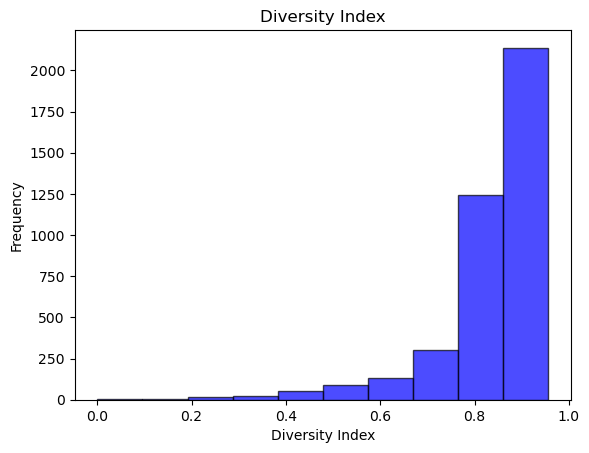

Column: model
model
biomass    2014
impact     1985
Name: count, dtype: int64


Frequency of Diversity_index in each column:
                         site                                            \
                1001188_1377U 1001327_3209U 1001328_1367U 1006376_1363U   
Diversity_index                                                           
0.000000                    0             0             0             0   
0.070070                    0             0             0             0   
0.070601                    0             0             0             0   
0.109675                    0             0             0             0   
0.114295                    0             0             0             0   
...                       ...           ...           ...           ...   
0.951640                    0             0             0             0   
0.952093                    0             0             0             0   
0.952767                    0             0       

In [106]:
# Plot histogram for Diversity_index
Cat_df['Diversity_index'].plot(kind='hist', bins=10, alpha=0.7, color='blue', edgecolor='black', title='Diversity Index')
plt.xlabel('Diversity Index')
plt.ylabel('Frequency')
plt.show()

# Calculate and display frequency of each label in individual columns
for col in Cat_df.columns:
    if col not in ['Diversity_index', 'site']:
        print(f"Column: {col}")
        freq_counts = df[col].value_counts()
        print(freq_counts)
        print("\n")
        # Calculate frequency of Diversity_index in each column
        freq_by_column = Cat_df.groupby('Diversity_index').apply(lambda x: x.apply(pd.Series.value_counts)).unstack().fillna(0).astype(int)
        
        print("Frequency of Diversity_index in each column:")
        print(freq_by_column)

In [82]:
Num_df.describe()

,Year,Latitude,Longitude,Depth,Coral_cover,Reef_complexity,SST,NPP,Wave_exposure,Coral_area_UFRTM_20km,...,Rec_reliance,Commercial_pounds_landed,Pop_per_area_reef_20km,Random,impact,YEAR,PCT_CORAL,MAX_HARD_RELIEF,no.divers,Diversity_index
count,3999.000000,3999.000000,3999.000000,3999.000000,3292.000000,3292.000000,3999.000000,3999.000000,3999.000000,3999.000000,...,3910.000000,3.998000e+03,3999.000000,3999.000000,2779.000000,3999.000000,3292.000000,3292.000000,3999.000000,3999.000000
mean,2012.886222,25.361813,-80.912910,12.031226,4.549820,1.100154,23.760696,523.320811,7.322459,76727.255314,...,0.424433,6.312866e+05,6.386781,5047.471618,0.400637,2012.886222,4.549820,1.100154,3.115779,0.831469
std,3.629448,0.806724,1.051129,6.942690,5.522744,0.851008,0.552442,163.404174,0.211270,44693.794158,...,2.247541,4.861803e+05,11.092795,2919.598275,0.281552,3.629448,5.522744,0.851008,0.998422,0.114777
min,2005.000000,24.431943,-82.986818,1.300482,0.000000,0.075887,22.405206,287.664307,5.213092,12257.000000,...,-0.185000,1.706314e+05,0.000000,1.000000,0.000000,2005.000000,0.000000,0.075887,2.000000,0.000000
25%,2011.000000,24.632586,-81.695419,6.351316,1.500000,0.500000,23.608484,365.925385,7.294437,50594.000000,...,-0.185000,2.469954e+05,0.039136,2550.500000,0.174000,2011.000000,1.500000,0.500000,2.000000,0.811582
50%,2013.000000,25.123213,-80.292226,10.171806,2.758143,0.900596,23.929285,533.677063,7.368210,60682.000000,...,-0.185000,3.180504e+05,0.248873,5097.000000,0.382000,2013.000000,2.758143,0.900596,4.000000,0.867035
75%,2016.000000,26.034196,-80.092946,17.148568,5.283544,1.448243,24.200861,632.628479,7.455595,91516.000000,...,0.044000,8.556702e+05,12.681632,7602.000000,0.694000,2016.000000,5.283544,1.448243,4.000000,0.900148
max,2018.000000,27.189445,-79.993800,32.295441,55.000000,10.538338,24.436212,1330.589233,7.597482,280125.000000,...,12.140000,1.511066e+06,55.371104,9997.000000,1.000000,2018.000000,55.000000,10.538338,8.000000,0.956324


<Axes: xlabel='Diversity_index', ylabel='Coral_cover'>

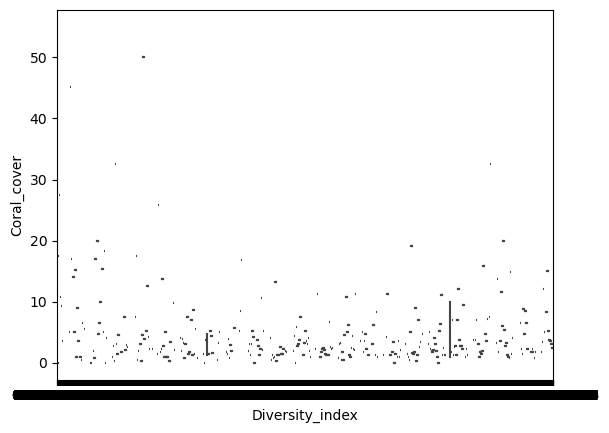

In [86]:
sns.boxplot(x=df['Diversity_index'], y=df['Coral_cover'])

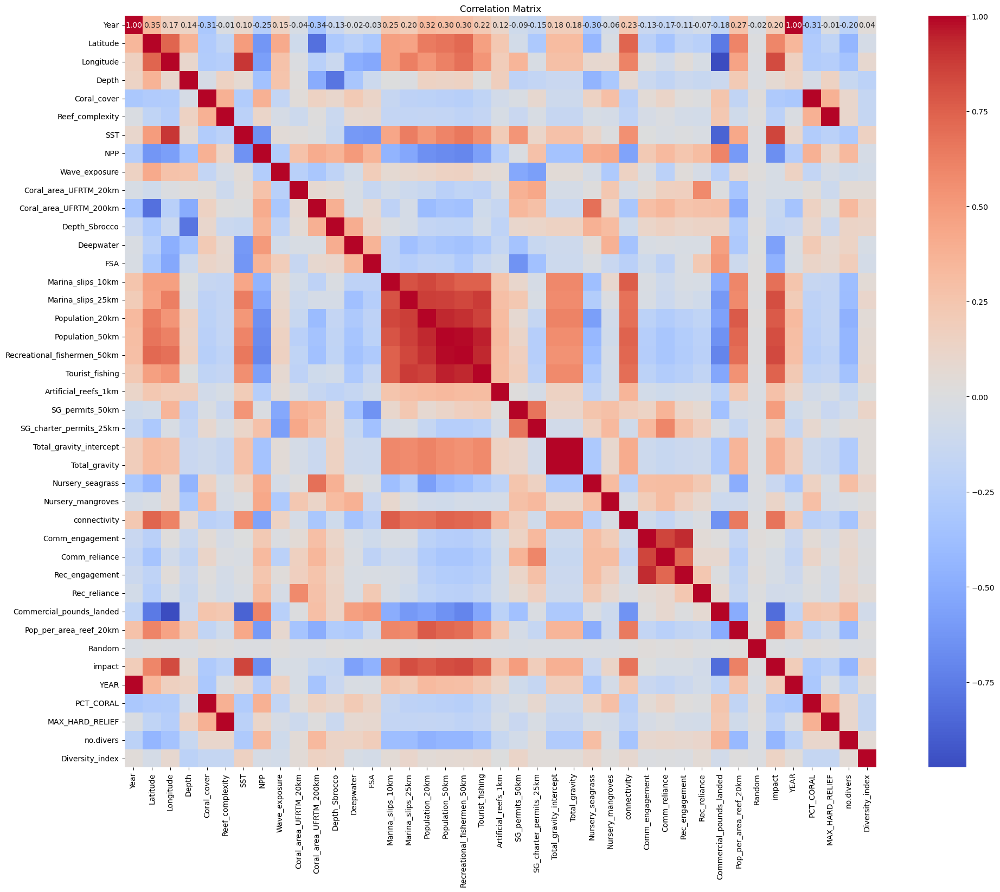

In [114]:

# Calculate the correlation matrix
corr_matrix = Num_df.corr()

# Plot the heatmap
plt.figure(figsize=(25, 18))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True)
plt.title('Correlation Matrix')
plt.show()

In [92]:
pip install pandas folium



   ---------------------------------------- 0.0/108.4 kB ? eta -:--:--
   --- ------------------------------------ 10.2/108.4 kB ? eta -:--:--
   ---------------------- ---------------- 61.4/108.4 kB 825.8 kB/s eta 0:00:01
   ---------------------------------------- 108.4/108.4 kB 1.3 MB/s eta 0:00:00


In [93]:
import folium
from folium.plugins import MarkerCluster

In [94]:
# Create a folium map centered around the average latitude and longitude
m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=8)

# Add a marker cluster to the map
marker_cluster = MarkerCluster().add_to(m)

# Add points to the map
for idx, row in df.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=f"Coral Cover: {row['Coral_cover']}<br>Diversity Index: {row['Diversity_index']}",
        icon=folium.Icon(color='blue', icon='info-sign')
    ).add_to(marker_cluster)

# Display the map
m.save('map.html')
m

In [95]:
pip install pandas plotly


In [96]:
import plotly.express as px

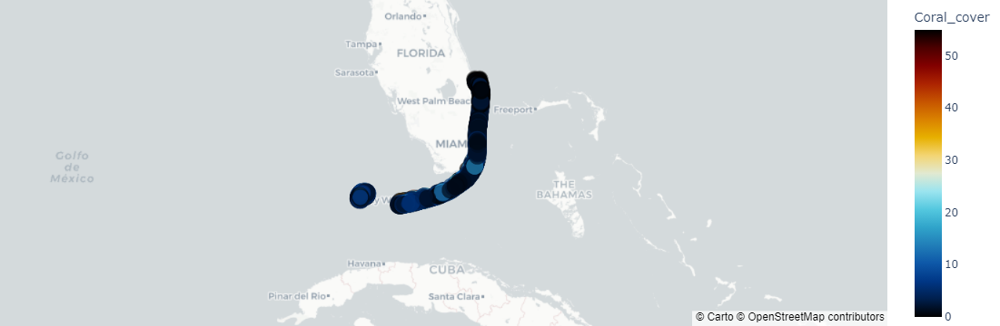

In [97]:
# Create a scatter mapbox plot
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Year", hover_data=["Coral_cover", "Diversity_index"],
                        color="Coral_cover", size="Diversity_index", color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=5)

fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()

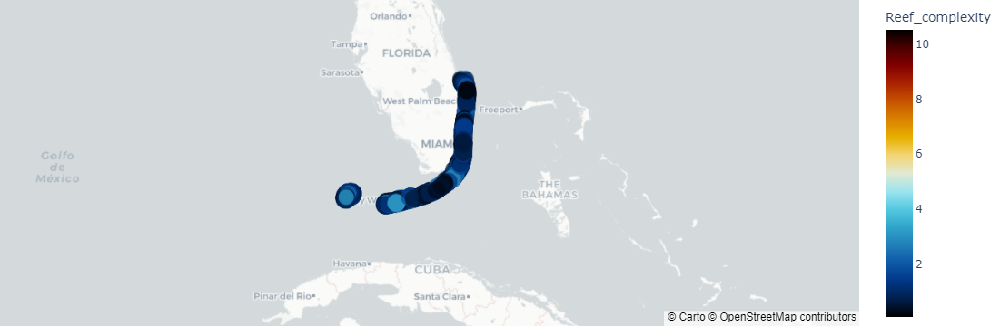

In [98]:
# Create a scatter mapbox plot
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Year", hover_data=["Reef_complexity", "Diversity_index"],
                        color="Reef_complexity", size="Diversity_index", color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=5)

fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()

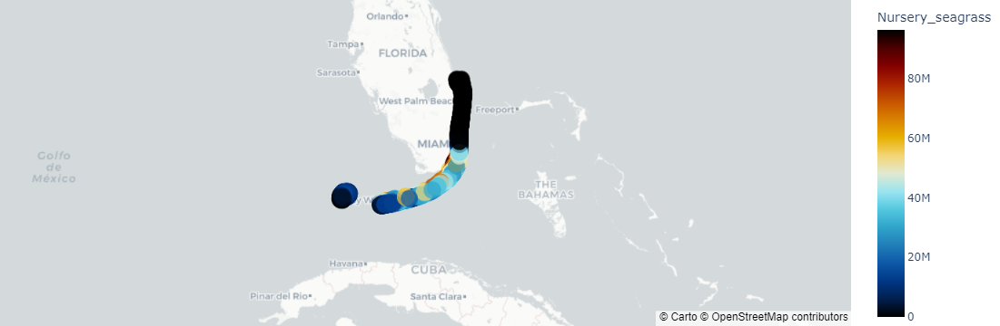

In [110]:
# Create a scatter mapbox plot
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Year", hover_data=["Nursery_seagrass", "Diversity_index"],
                        color="Nursery_seagrass", size="Diversity_index", color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=5)

fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()